In [1]:
from src import _PATH_DATA, _PATH_MODELS, _PROJECT_ROOT
import torch
import torch._dynamo
from glob import glob
import pandas as pd
from tqdm import tqdm
import tifffile
from skimage import measure
import numpy as np

# Models
from src.models.unet import UNet_pl
from monai.networks.nets.segresnet import SegResNet
# from monai.networks.nets import SwinUNETR

# Feature extraction
from torchvision.models.feature_extraction import create_feature_extractor,get_graph_node_names
import umap

# Dataloaders
from src.data.dataloaders import BugNISTDataModule
from src.data.dataloaders import MetricDataset
from torch.utils.data import DataLoader

# Visualization
import plotly.express as px
import plotly.io as pio
import matplotlib.pyplot as plt

pio.templates.default = "ggplot2"

In [2]:
# model = UNet_pl(
#         spatial_dims=3,
#         in_channels=1,
#         out_channels=13,
#         channels=(16, 32, 64, 128, 256, 512),
#         strides=(2, 2, 2, 2, 2),
#         num_res_units = 3,
#         )

# model_path = f"{_PATH_MODELS}/UNet_large-2023-12-06-1549/UNet-epoch=79.ckpt"
        
# model.load_state_dict(torch.load(model_path, map_location="cpu")['state_dict'], strict=True)

<All keys matched successfully>

In [2]:
model = SegResNet(spatial_dims= 3,
                  init_filters= 32,
                  in_channels= 1,
                  out_channels= 105,
                 )
model.load_state_dict(torch.load("model_SegResNet.pt"));
model.eval();

feature_extractor = create_feature_extractor(model,["down_layers"])
feature_extractor = feature_extractor.to("cuda")

In [14]:
# bugnist = BugNISTDataModule(batch_size=5, num_workers=0, mix=True,no_noise=False)
# bugnist_no_noise = BugNISTDataModule(batch_size=5, num_workers=0, mix=True,no_noise=True)
# bugnist_old = BugNISTDataModule(batch_size=5, num_workers=0, mix=True,no_noise=False,old=True)
bugnist = BugNISTDataModule(batch_size=5, num_workers=0, mix=True,no_noise=False,old=True,gan=False)

bugnist.setup()
# bugnist_no_noise.setup()
# bugnist_old.setup()

# synthetic_no_noise_loader = bugnist_no_noise.train_dataloader()
# synthetic_old_loader = bugnist_old.train_dataloader()
synthetic_loader = bugnist.test_dataloader()

real_loader = DataLoader(MetricDataset(),
                         batch_size=5,
                         num_workers=0)

In [10]:
# outputs_synthetic_old = []
# for img,_ in tqdm(synthetic_old_loader, unit="batch"):
#     img = img.to("cuda")
#     with torch.no_grad():
#         out = feature_extractor(img)
#         outputs_synthetic_old.append(out['down_layers'].cpu())

# outputs_synthetic_old = torch.concat(outputs_synthetic_old,dim=0)
# outputs_synthetic_old_flat = outputs_synthetic_old.flatten(start_dim=1)

# np.save("synthetic_old_SegResNet_features.npy",outputs_synthetic_old_flat.numpy())

# del outputs_synthetic_old
# del outputs_synthetic_old_flat

100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [10:26<00:00,  1.25s/batch]


In [11]:
outputs_synthetic = []
for img,_ in tqdm(synthetic_loader, unit="batch"):
    img = img.to("cuda")
    with torch.no_grad():
        out = feature_extractor(img)
        outputs_synthetic.append(out['down_layers'].cpu())

outputs_synthetic = torch.concat(outputs_synthetic,dim=0)
outputs_synthetic_flat = outputs_synthetic.flatten(start_dim=1)

np.save("./features/loose_packing_SegResNet_features.npy",outputs_synthetic_flat.numpy())

del outputs_synthetic
del outputs_synthetic_flat

100%|██████████| 100/100 [01:43<00:00,  1.04s/batch]


In [12]:
# outputs_synthetic_no_noise = []
# for img,_ in tqdm(synthetic_no_noise_loader, unit="batch"):
#     img = img.to("cuda")
#     with torch.no_grad():
#         out = feature_extractor(img)
#         outputs_synthetic_no_noise.append(out['down_layers'].cpu())

# outputs_synthetic_no_noise = torch.concat(outputs_synthetic_no_noise,dim=0)
# outputs_synthetic_no_noise_flat = outputs_synthetic_no_noise.flatten(start_dim=1)

# np.save("synthetic_no_noise_SegResNet_features.npy",outputs_synthetic_no_noise_flat.numpy())

# del outputs_synthetic_no_noise
# del outputs_synthetic_no_noise_flat

100%|████████████████████████████████████████████████████████████████████████████| 1000/1000 [22:05<00:00,  1.33s/batch]


In [15]:
outputs_real = []
for img,_ in tqdm(real_loader, unit="batch"):
    img = img.to("cuda")
    with torch.no_grad():
        out = feature_extractor(img)
        outputs_real.append(out['down_layers'].cpu())

outputs_real = torch.concat(outputs_real,dim=0)
outputs_real_flat = outputs_real.flatten(start_dim=1)

np.save("real_SegResNet_features.npy",outputs_real_flat.numpy())

del outputs_real
del outputs_real_flat

100%|██████████| 78/78 [01:26<00:00,  1.11s/batch]


In [16]:
outputs_real = np.load("./features/real_SegResNet_features.npy")
outputs_tight_packing_wn = np.load("./features/tight_packing_wn_SegResNet_features.npy")
outputs_tight_packing_nn = np.load("./features/tight_packing_nn_SegResNet_features.npy")
outputs_loose_packing = np.load("./features/loose_packing_SegResNet_features.npy")
outputs_gan = np.load("./features/gan_SegResNet_features.npy")
outputs = np.concatenate((outputs_real,outputs_tight_packing_wn,outputs_tight_packing_nn,outputs_loose_packing,outputs_gan), axis=0)

In [17]:
reducer = umap.UMAP(n_neighbors=25,n_components=2)
embedding = reducer.fit_transform(outputs)

In [19]:
np.save("Embedding_SegResNet.npy",embedding)

In [2]:
# embedding = np.load("embedding_SegResNet.npy")

In [2]:
def chart(X, y, dim = 3):
    #--------------------------------------------------------------------------#
    # This section is not mandatory as its purpose is to sort the data by label 
    # so, we can maintain consistent colors for digits across multiple graphs
    img_paths_train = pd.read_csv(f"{_PATH_DATA}/train.csv")["img_path"]
    img_paths_test = pd.read_csv(f"{_PATH_DATA}/test.csv")["img_path"]
    img_paths_TPNN = pd.read_csv(f"{_PATH_DATA}/test_no_noise.csv")["img_path"]
    img_paths_LP = pd.read_csv(f"{_PATH_DATA}/test_old.csv")["img_path"]
    img_paths_real = pd.read_csv(f"{_PATH_DATA}/mixed_and_label_paths.csv")["img_path"]
    img_paths_gan = pd.read_csv(f"{_PATH_DATA}/test.csv")["gan_img_path"]
    # Concatenate X and y arrays
    arr_concat=np.concatenate((X, y.reshape(y.shape[0],1)), axis=1)
    # Create a Pandas dataframe using the above array
    if dim == 3:
        df=pd.DataFrame(arr_concat, columns=['x', 'y', 'z', 'label'])
    elif dim == 2:
        df=pd.DataFrame(arr_concat, columns=['x', 'y', 'label'])
    else:
        print("Can only use dim = 2 or 3")
        return
    # Convert label data type from float to integer
    df['label'] = df['label'].astype(int)
    df['path'] = ""
    df.loc[:387,"path"] = list(img_paths_real)
    df.loc[388:887,"path"] = list(img_paths_test)
    df.loc[888:1387,"path"] = list(img_paths_TPNN)
    df.loc[1388:1887,"path"] = list(img_paths_LP)
    df.loc[1888:,"path"] = list(img_paths_gan)
    # Finally, sort the dataframe by label
    df.sort_values(by='label', axis=0, ascending=True, inplace=True)

    number_to_name = {0:"Real", 1:"Tight Packing (wn) Test", 2:"Tight Packing (nn)",3:"Loose Packing",4:"GAN"}

    df.label = df.label.apply(lambda x: number_to_name[x])
    #--------------------------------------------------------------------------#
    
    # Create a 3D graph
    if dim == 3:
        fig = px.scatter_3d(df, x='x', y='y', z='z', color=df['label'].astype(str), height=900, width=950)
        # Update chart looks
        fig.update_layout(title_text='UMAP',
                          showlegend=True,
                          legend=dict(orientation="h", yanchor="top", y=0, xanchor="center", x=0.5),
                          scene_camera=dict(up=dict(x=0, y=0, z=1), 
                                                center=dict(x=0, y=0, z=-0.1),
                                                eye=dict(x=1.5, y=-1.4, z=0.5)),
                                                margin=dict(l=0, r=0, b=0, t=0),
                          scene = dict(xaxis=dict(backgroundcolor='white',
                                                  color='black',
                                                  gridcolor='#f0f0f0',
                                                  title_font=dict(size=10),
                                                  tickfont=dict(size=10),
                                                 ),
                                       yaxis=dict(backgroundcolor='white',
                                                  color='black',
                                                  gridcolor='#f0f0f0',
                                                  title_font=dict(size=10),
                                                  tickfont=dict(size=10),
                                                  ),
                                       zaxis=dict(backgroundcolor='lightgrey',
                                                  color='black', 
                                                  gridcolor='#f0f0f0',
                                                  title_font=dict(size=10),
                                                  tickfont=dict(size=10),
                                                 )))
    
    elif dim == 2:
        fig = px.scatter(df, x='x', y='y', color=df['label'].astype(str), hover_name='path', height=900, width=950, color_discrete_sequence=px.colors.qualitative.Safe)
        # fig = px.density_contour(df, x='x', y='y', color=df['label'].astype(str), height=900, width=950)
    # Update marker size
    fig.update_traces(marker=dict(size=5, line=dict(color='black', width=0.2)))
    
    fig.show()

In [20]:
y = np.zeros((2388,))
y[388:888] = 1
y[888:1388] = 2
y[1388:1888] = 3
y[1888:] = 4

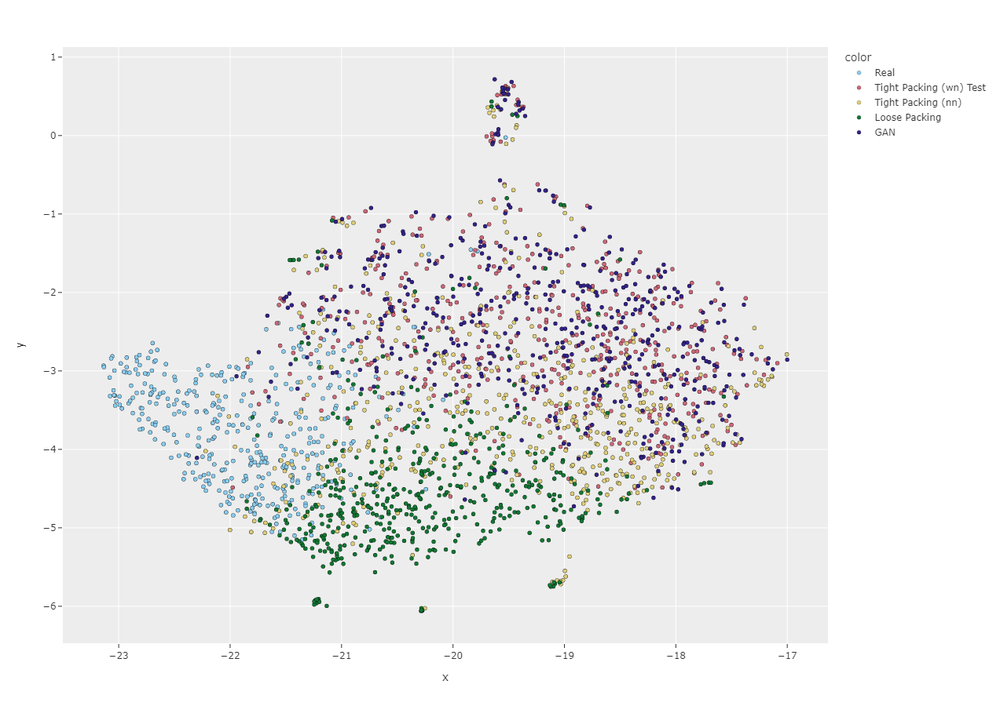

In [23]:
chart(embedding, y, dim = 2)

In [35]:
from sklearn.decomposition import PCA

In [37]:
pca = PCA()

In [38]:
outputs_real = np.load("./features/real_UNet_features.npy")
outputs_tight_packing_wn_test = np.load("./features/tight_packing_wn_test_UNet_features.npy")
outputs_tight_packing_wn_train = np.load("./features/tight_packing_wn_train_UNet_features.npy")
outputs_tight_packing_nn = np.load("./features/tight_packing_nn_UNet_features.npy")
outputs_loose_packing = np.load("./features/loose_packing_UNet_features.npy")
# outputs_gan = np.load("./features/gan_test_UNet_features.npy")
outputs = np.concatenate((outputs_real,outputs_tight_packing_wn_test,outputs_tight_packing_nn,outputs_loose_packing,outputs_tight_packing_wn_train), axis=0)

In [40]:
pca.fit(outputs)

PCA()

In [41]:
transformed_outputs = pca.transform(outputs)

In [44]:
evr = pca.explained_variance_ratio_

In [48]:
transformed_outputs.shape

(21888, 21888)

In [ ]:
np.save(transforme

In [9]:
reducer = umap.UMAP(n_neighbors=25,n_components=2,random_state=42,densmap=False)
embedding = reducer.fit_transform(outputs)

# embedding = np.load("Embedding_UNet.npy")

/work3/s164564/envs/thesis/lib/python3.10/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


In [10]:
outputs_tight_packing_wn_train = np.load("./features/tight_packing_wn_train_UNet_features.npy")

In [11]:
embedding_train = reducer.transform(outputs_tight_packing_wn_train)
# embedding_gan = reducer.transform(outputs_gan)

In [12]:
embedding_all = np.concatenate((embedding,embedding_train))

In [13]:
embedding_all.shape

(21888, 2)

In [22]:
y = np.zeros((21888,))
y[388:888] = 1
y[888:1388] = 2
y[1388:1888] = 3
y[1888:] = 4

In [17]:
# y = np.zeros((21888,))
# y[388:888] = 1
# y[888:1388] = 2
# y[1388:1888] = 3
# y[1888:2388] = 4
# y[2388:] = 5

In [15]:
img_paths_train = pd.read_csv(f"{_PATH_DATA}/train.csv")["img_path"]
img_paths_test = pd.read_csv(f"{_PATH_DATA}/test.csv")["img_path"]
img_paths_TPNN = pd.read_csv(f"{_PATH_DATA}/test_no_noise.csv")["img_path"]
img_paths_LP = pd.read_csv(f"{_PATH_DATA}/test_old.csv")["img_path"]
img_paths_real = pd.read_csv(f"{_PATH_DATA}/mixed_and_label_paths.csv")["img_path"]
img_paths_gan = pd.read_csv(f"{_PATH_DATA}/test.csv")["gan_img_path"]

In [23]:
#--------------------------------------------------------------------------#
# This section is not mandatory as its purpose is to sort the data by label 
# so, we can maintain consistent colors for digits across multiple graphs

# Concatenate X and y arrays
arr_concat=np.concatenate((embedding_all, y.reshape(y.shape[0],1)), axis=1)
# Create a Pandas dataframe using the above array

df=pd.DataFrame(arr_concat, columns=['x', 'y', 'label'])
# Convert label data type from float to integer
df['label'] = df['label'].astype(int)

In [24]:
df['path'] = ""
df.loc[:387,"path"] = list(img_paths_real)
df.loc[388:887,"path"] = list(img_paths_test)
df.loc[888:1387,"path"] = list(img_paths_TPNN)
df.loc[1388:1887,"path"] = list(img_paths_LP)
# df.loc[1888:2387,"path"] = list(img_paths_gan)
# df.loc[2388:,"path"] = list(img_paths_train)
df.loc[1888:,"path"] = list(img_paths_train)

In [25]:
# Finally, sort the dataframe by label
df.sort_values(by='label', axis=0, ascending=True, inplace=True)

number_to_name = {0:"Real", 1:"Tight Packing (wn) Test", 2:"Tight Packing (nn)",3:"Loose Packing",4:"Tight Packing (wn) Train"}
# number_to_name = {0:"Real", 1:"Tight Packing (wn) Test", 2:"Tight Packing (nn)",3:"Loose Packing",4:"GAN",5:"Tight Packing (wn) Train"}

df.label = df.label.apply(lambda x: number_to_name[x])

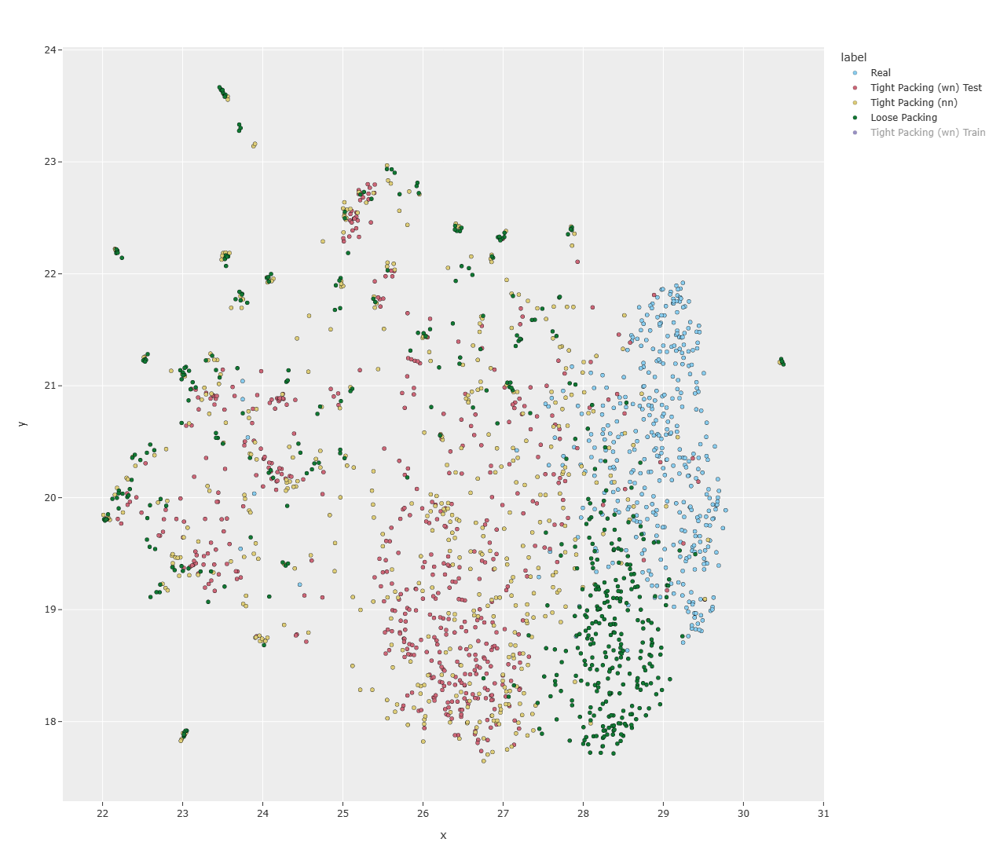

In [26]:
#--------------------------------------------------------------------------#

fig = px.scatter(df, x='x', y='y', color='label',hover_name='path', height=1100, width=1150, color_discrete_sequence=px.colors.qualitative.Safe)

# Update marker size
fig.update_traces(marker=dict(size=5, line=dict(color='black', width=0.2)))

fig.show()

In [27]:
poi = df[(df.label == "Tight Packing (wn) Train") & (df.x > 27.5) & (df.y < 22) & (df.y > 18.5)]

In [34]:
poi.path.to_csv("list_of_training_mixes.csv",index=False)

In [76]:
poi = df[(df.label == "Tight Packing (wn) Train") & (df.x < 11) & (df.y < 12.5) & (df.y > 10)]

In [77]:
number_of_each_insect = {"BF":0,
                         "CF":0,
                         "PP":0,
                         "MA":0,
                         "BL":0,
                         "ML":0,
                         "SL":0,
                         "WO":0,
                         "BC":0,
                         "GH":0,
                         "AC":0,
                         "GP":0}
number_of_insects = []
for path in poi.path:
    folder_path = "/".join(path.split("/")[:-1])
    number = path.split("/")[-1][4:-4]
    df_temp = pd.read_csv(f"{_PATH_DATA}/{folder_path}/centroids_{number}.csv",sep=";")
    for insect in df_temp.Caption:
        number_of_each_insect[insect] += 1
    number_of_insects.append(len(df_temp))

In [41]:
np.array(number_of_insects).mean()

6.231994459833795

In [78]:
number_of_each_insect

{'BF': 1329,
 'CF': 1694,
 'PP': 1774,
 'MA': 1710,
 'BL': 1764,
 'ML': 1196,
 'SL': 1105,
 'WO': 1743,
 'BC': 1456,
 'GH': 1160,
 'AC': 1290,
 'GP': 1777}

In [79]:
poi = df[(df.label == "Tight Packing (wn) Train") & (df.x > 11)]
number_of_each_insect = {"BF":0,
                         "CF":0,
                         "PP":0,
                         "MA":0,
                         "BL":0,
                         "ML":0,
                         "SL":0,
                         "WO":0,
                         "BC":0,
                         "GH":0,
                         "AC":0,
                         "GP":0}
number_of_insects = []
for path in poi.path:
    folder_path = "/".join(path.split("/")[:-1])
    number = path.split("/")[-1][4:-4]
    df_temp = pd.read_csv(f"{_PATH_DATA}/{folder_path}/centroids_{number}.csv",sep=";")
    for insect in df_temp.Caption:
        number_of_each_insect[insect] += 1
    number_of_insects.append(len(df_temp))

print(number_of_each_insect)

{'BF': 860, 'CF': 1131, 'PP': 1131, 'MA': 1181, 'BL': 1220, 'ML': 806, 'SL': 724, 'WO': 1096, 'BC': 904, 'GH': 811, 'AC': 858, 'GP': 1172}


In [80]:
np.array(number_of_insects).mean()

6.246848739495798

In [ ]:
investigating synthetic data for semantic segmentation 

In [29]:
df_temp

,Caption,PosX,PosY,PosZ
0,SL,68.637316,53.412230,73.252695
1,GH,52.344966,65.791181,164.018037
2,CF,79.644220,85.917687,182.731279
3,MA,33.906702,47.322930,16.447744


In [54]:
df[df.label == "Real"].y.max()

9.843280792236328

In [16]:
y = np.zeros((1888,))
y[388:888] = 1
y[888:1388] = 2
y[1388:] = 3

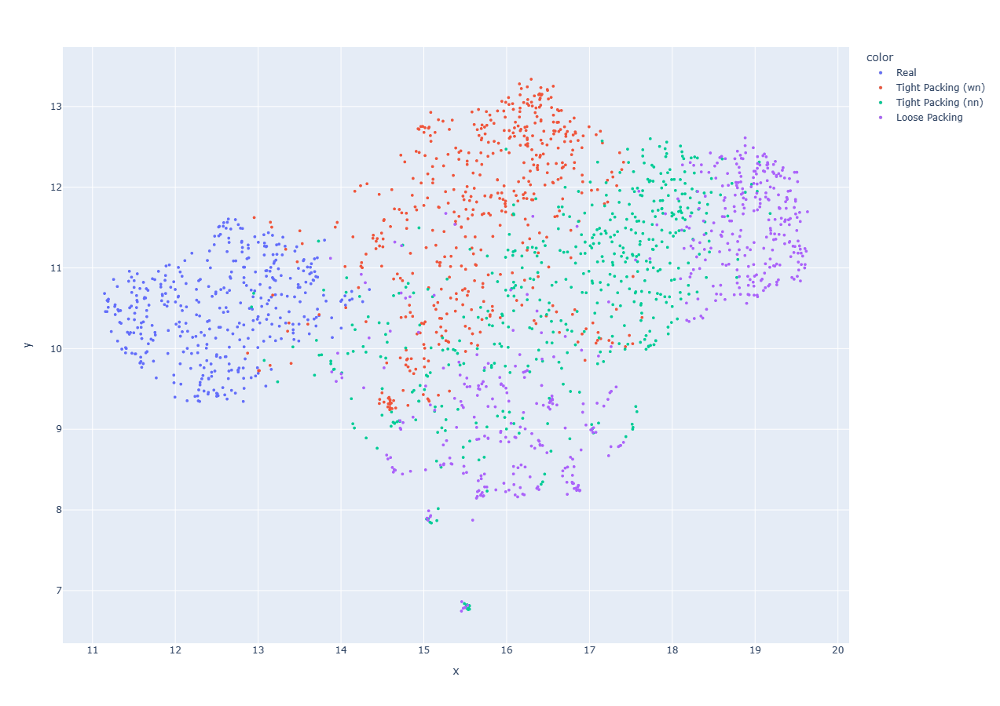

In [20]:
chart(embedding, y, dim = 2)

# Feature distance subset creation

In [30]:
from scipy.spatial.distance import cdist
import numpy as np
import pandas as pd

In [31]:
real = np.load("./features/real_UNetNoSkipConnection_features.npy")
synthetic = np.load("./features/dense_packing_wn_train_UNetNoSkipConnection_features.npy")
data = np.concatenate((real,synthetic), axis=0)

In [32]:
subset_1 = data[:388]
subset_2 = data[388:]

In [33]:
# Calculate distances between subset 1 and subset 2 using Euclidean distance
distances = cdist(subset_1, subset_2, 'euclidean')

In [34]:
distances2 = cdist(subset_1, subset_1, 'euclidean')

In [35]:
distances2 = np.ma.array(distances2, mask=False)
for i in range(distances2.shape[0]):
    distances2.mask[i,i] = True

In [39]:
close_points = np.argwhere(distances.mean(axis=0) < distances2.mean())

In [40]:
poi = np.unique(close_points)

In [41]:
distances.mean(axis=0)

array([856.58570499, 834.81851408, 948.81785538, ..., 909.5584192 ,
       855.27292439, 915.67326118])

In [36]:
data_train = pd.read_csv("../data/train_v3.csv")

In [37]:
data_train["distances"] = distances.mean(axis=0)

In [48]:
data_train.sort_values(by="distances")[:20000].to_csv("train_feature_distance_subset.csv",index=False)

In [46]:
distances2.mean()

857.914875608836

In [47]:
distances2.std()

51.05536610115451

In [37]:
# import pandas as pd
# umap_training_mixes = pd.read_csv("list_of_training_mixes.csv")
# data_train = pd.read_csv("../data/train.csv")
# umap_training_mixes.sort_values("path",ignore_index=True,inplace=True)
# merged_df = pd.merge(data_train, umap_training_mixes, how='inner', left_on='img_path', right_on='path')
# merged_df.drop("path",axis=1,inplace=True)
# merged_df.to_csv("train_umap.csv",index=False)

# Create PCA subset

In [1]:
from scipy.spatial.distance import cdist
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA

In [2]:
pca = PCA()

In [3]:
real = np.load("./features/real_UNetNoSkipConnection_features.npy")
dense_wn = np.load("./features/dense_packing_wn_test_UNetNoSkipConnection_features.npy")
dense_nn = np.load("./features/dense_packing_nn_test_UNetNoSkipConnection_features.npy")
dense_nn = dense_nn[:500]
light = np.load("./features/light_packing_test_UNetNoSkipConnection_features.npy")
dense_wn_train = np.load("./features/dense_packing_wn_train_UNetNoSkipConnection_features.npy")

outputs = np.concatenate((real,dense_wn,dense_nn,light), axis=0)

In [4]:
pca.fit(outputs)

PCA()

In [5]:
transformed_real = pca.transform(outputs[:388])

In [6]:
transformed_train = pca.transform(dense_wn_train)

In [7]:
pca.explained_variance_ratio_

array([1.8731927e-02, 8.8734115e-03, 8.5480139e-03, ..., 8.5701526e-05,
       7.6175347e-05, 1.1738994e-13], dtype=float32)

In [8]:
subset_1 = transformed_real
subset_2 = transformed_train

In [9]:
# Calculate distances between subset 1 and subset 2 using Euclidean distance
distances = cdist(subset_1, subset_2, 'euclidean')

In [10]:
distances2 = cdist(subset_1, subset_1, 'euclidean')
distances2 = np.ma.array(distances2, mask=False)
for i in range(distances2.shape[0]):
    distances2.mask[i,i] = True

In [11]:
data_train = pd.read_csv("../data/train_v3.csv")

In [12]:
data_train["distances"] = distances.mean(axis=0)

In [14]:
data_train.sort_values(by="distances")[:20000].to_csv("pca_subset.csv",index=False)

# Create UMAP subset and plot

In [1]:
from src import _PATH_DATA, _PATH_MODELS, _PROJECT_ROOT
import torch
import torch._dynamo
from glob import glob
import pandas as pd
from tqdm import tqdm
import tifffile
from skimage import measure
import numpy as np
from scipy.spatial.distance import cdist

# Models
from src.models.unet import UNet_pl
from monai.networks.nets.segresnet import SegResNet
# from monai.networks.nets import SwinUNETR

# Feature extraction
from torchvision.models.feature_extraction import create_feature_extractor,get_graph_node_names
import umap

# Dataloaders
from src.data.dataloaders import BugNISTDataModule
from src.data.dataloaders import MetricDataset
from torch.utils.data import DataLoader

# Visualization
import plotly.express as px
import plotly.io as pio
import matplotlib.pyplot as plt

pio.templates.default = "plotly_white"#"ggplot2"

In [77]:
def chart(X, y, dim = 3,df=None,df_given=False):
    #--------------------------------------------------------------------------#
    # This section is not mandatory as its purpose is to sort the data by label 
    # so, we can maintain consistent colors for digits across multiple graphs
    if df_given == False:
        img_paths_dense_wn_train = pd.read_csv(f"{_PATH_DATA}/train_v3.csv")["img_path"]
        img_paths_dense_wn = pd.read_csv(f"{_PATH_DATA}/test_v3.csv")["img_path"]
        img_paths_dense_nn = pd.read_csv(f"{_PATH_DATA}/test_v2.csv")["img_path"][:500]
        img_paths_light = pd.read_csv(f"{_PATH_DATA}/test_v1.csv")["img_path"]
        img_paths_real = pd.read_csv(f"{_PATH_DATA}/mixed_and_label_paths.csv")["img_path"]
        # Concatenate X and y arrays
        arr_concat=np.concatenate((X, y.reshape(y.shape[0],1)), axis=1)
        # Create a Pandas dataframe using the above array
        if dim == 3:
            df=pd.DataFrame(arr_concat, columns=['x', 'y', 'z', 'label'])
        elif dim == 2:
            df=pd.DataFrame(arr_concat, columns=['x', 'y', 'label'])
        else:
            print("Can only use dim = 2 or 3")
            return
        # Convert label data type from float to integer
        df['label'] = df['label'].astype(int)
        df['path'] = ""
        df.loc[:387,"path"] = list(img_paths_real)
        df.loc[388:887,"path"] = list(img_paths_dense_wn)
        df.loc[888:1387,"path"] = list(img_paths_dense_nn)
        # df.loc[1388:,"path"] = list(img_paths_light)
        df.loc[1388:1887,"path"] = list(img_paths_light)
        df.loc[1888:,"path"] = list(img_paths_dense_wn_train)
        # Finally, sort the dataframe by label
        df.sort_values(by='label', axis=0, ascending=True, inplace=True)
    
        # number_to_name = {0:"Real", 1:"Dense Packing w/bg", 2:"Dense Packing",3:"Light Packing"}
        number_to_name = {0:"Real", 1:"Dense Packing w/bg (test)", 2:"Dense Packing (test)",3:"Light Packing (test)",4:"Dense Packing w/bg (train)"}

        df["label_number"] = df.label
        df.label = df.label.apply(lambda x: number_to_name[x])
    else:
        df = df.sort_values(by="label_number")
        
    #--------------------------------------------------------------------------#
    
    # Create a 3D graph
    if dim == 3:
        fig = px.scatter_3d(df, x='x', y='y', z='z', color=df['label'].astype(str), height=900, width=950)
        # Update chart looks
        fig.update_layout(title_text='UMAP',
                          showlegend=True,
                          legend=dict(orientation="h", yanchor="top", y=0, xanchor="center", x=0.5),
                          scene_camera=dict(up=dict(x=0, y=0, z=1), 
                                                center=dict(x=0, y=0, z=-0.1),
                                                eye=dict(x=1.5, y=-1.4, z=0.5)),
                                                margin=dict(l=0, r=0, b=0, t=0),
                          scene = dict(xaxis=dict(backgroundcolor='white',
                                                  color='black',
                                                  gridcolor='#f0f0f0',
                                                  title_font=dict(size=10),
                                                  tickfont=dict(size=10),
                                                 ),
                                       yaxis=dict(backgroundcolor='white',
                                                  color='black',
                                                  gridcolor='#f0f0f0',
                                                  title_font=dict(size=10),
                                                  tickfont=dict(size=10),
                                                  ),
                                       zaxis=dict(backgroundcolor='lightgrey',
                                                  color='black', 
                                                  gridcolor='#f0f0f0',
                                                  title_font=dict(size=10),
                                                  tickfont=dict(size=10),
                                                 )))
    
    elif dim == 2:
        # fig = px.scatter(df, x='x', y='y', color=df['label'].astype(str), hover_name='path', height=900, width=950, color_discrete_sequence=px.colors.qualitative.Vivid)
        # fig = px.density_contour(df, x='x', y='y', color=df['label'].astype(str), height=900, width=950, color_discrete_sequence=px.colors.qualitative.Vivid)
        temp = px.colors.qualitative.Dark24
        color_sequence = [temp[0],temp[4],temp[2],temp[3],temp[5]]
        fig = px.density_contour(df, x='x', y='y',
                                 color=df['label'].astype(str),
                                 height=900, width=950,
                                 color_discrete_sequence=color_sequence)
    # Update marker size
    # fig.update_traces(marker=dict(size=5, line=dict(color='black', width=0.2)))
    fig.update_traces(line=dict(width=1.5))
    return df, fig

In [116]:
# real = np.load("./features/real_UNetNoSkipConnection_features.npy")
# dense_wn = np.load("./features/dense_packing_wn_test_UNetNoSkipConnection_features.npy")
# dense_nn = np.load("./features/dense_packing_nn_test_UNetNoSkipConnection_features.npy")
# dense_nn = dense_nn[:500]
# light = np.load("./features/light_packing_test_UNetNoSkipConnection_features.npy")
# dense_wn_train = np.load("./features/dense_packing_wn_train_UNetNoSkipConnection_features.npy")

# outputs = np.concatenate((real,dense_wn,dense_nn,light,dense_wn_train), axis=0)

In [117]:
# reducer = umap.UMAP(n_neighbors=50,n_components=2,random_state=42,densmap=False)
# embedding_all = reducer.fit_transform(outputs)
# np.save("embedding_all.npy",embedding_all)

/work3/s164564/envs/thesis/lib/python3.10/site-packages/umap/umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



In [20]:
# dense_wn_train = np.load("./features/dense_packing_wn_train_UNetNoSkipConnection_features.npy")

In [26]:
# embedding_train = reducer.transform(dense_wn_train)

In [27]:
# np.save("embedding_train.npy",embedding_train)
# np.save("embedding_tests.npy",embedding)

In [159]:
embedding_train = np.load("embedding_train.npy")
embedding = np.load("embedding_tests.npy")
embedding_all = np.concatenate((embedding,embedding_train), axis=0)

In [122]:
embedding_all = np.load("embedding_all.npy")

In [123]:
# y = np.zeros((1888,))
# y[388:888] = 1
# y[888:1388] = 2
# y[1388:] = 3
y = np.zeros((51888,))
y[388:888] = 1
y[888:1388] = 2
y[1388:1888] = 3
y[1888:] = 4

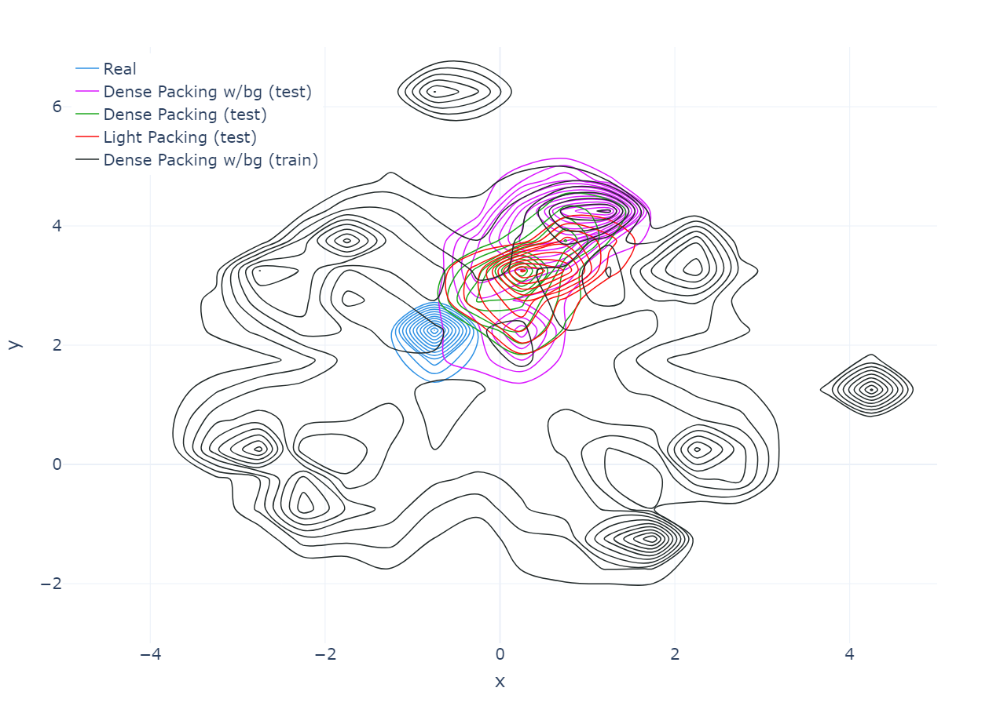

In [124]:
df, fig = chart(embedding_all, y, dim = 2)
fig.update_layout(legend=dict(yanchor="top",y=0.99,xanchor="left",x=0.01,title=""),font=dict(size=20))
fig.update_xaxes(range=[-5, 5])
fig.update_yaxes(range=[-3, 7])
fig.show()
fig.write_image("UMAP_before_selection.png")

In [125]:
x = df[df.label == "Real"].x.mean()
y = df[df.label == "Real"].y.mean()

In [126]:
corr = np.array([df[df.label == "Dense Packing w/bg (train)"].x,df[df.label == "Dense Packing w/bg (train)"].y]).swapaxes(0,1)

In [127]:
distances = cdist(corr,np.expand_dims(np.array([x,y]),axis=0))

In [128]:
df["distance"] = 0.0

In [129]:
df.loc[df.label == "Dense Packing w/bg (train)","distance"] = distances[:,0]

In [130]:
umap_subset_paths = df[df.label == "Dense Packing w/bg (train)"].sort_values(by="distance")[:20000].path

In [131]:
temp = df.sort_values(by="distance")[:21888]

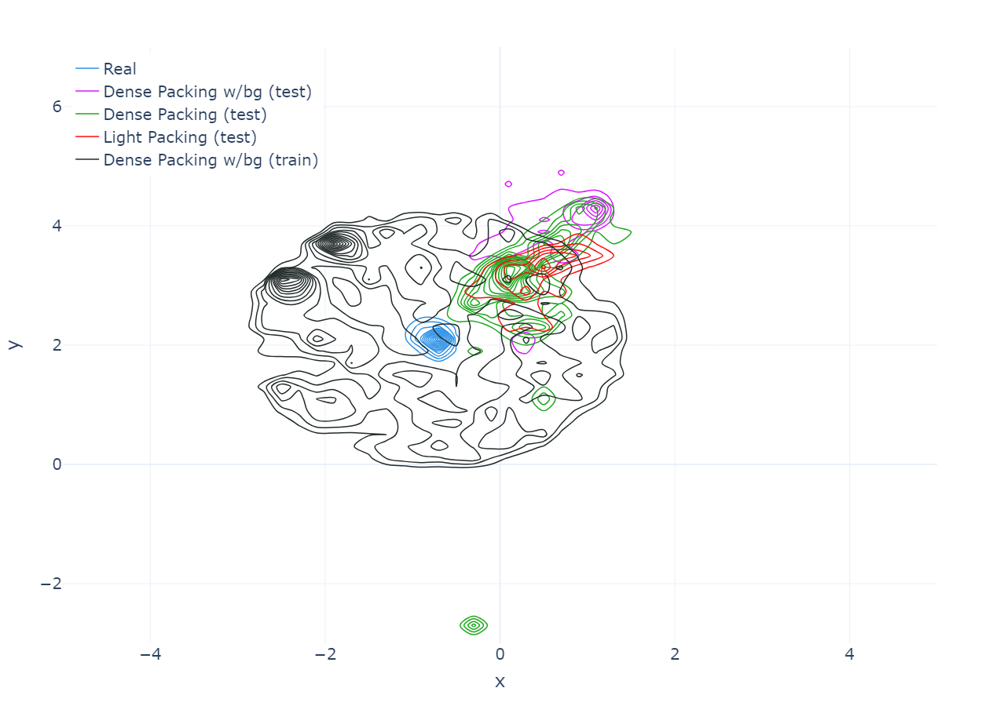

In [132]:
df_new, fig = chart(embedding_all, y, dim = 2, 
                df=temp,
               df_given=True)
fig.update_layout(legend=dict(yanchor="top",y=0.99,xanchor="left",x=0.01,title=""),font=dict(size=20))
fig.update_xaxes(range=[-5, 5])
fig.update_yaxes(range=[-3, 7])

fig.show()
fig.write_image("UMAP_after_selection.png")

In [64]:
umap_subset_paths.sort_values()

1888     synthetic_mixed_256_v3/train/000/mix_07100.tif
1890     synthetic_mixed_256_v3/train/000/mix_07102.tif
1892     synthetic_mixed_256_v3/train/000/mix_07104.tif
1893     synthetic_mixed_256_v3/train/000/mix_07105.tif
1895     synthetic_mixed_256_v3/train/000/mix_07107.tif
                              ...                      
51871    synthetic_mixed_256_v3/train/499/mix_49983.tif
51880    synthetic_mixed_256_v3/train/499/mix_49992.tif
51885    synthetic_mixed_256_v3/train/499/mix_49997.tif
51886    synthetic_mixed_256_v3/train/499/mix_49998.tif
51887    synthetic_mixed_256_v3/train/499/mix_49999.tif
Name: path, Length: 20000, dtype: object

In [67]:
full_dataset = pd.read_csv(f"{_PATH_DATA}/train_v3.csv")

In [69]:
merged_df = pd.merge(full_dataset, umap_subset_paths, how='inner', left_on='img_path', right_on='path')
merged_df.drop("path",axis=1,inplace=True)
merged_df.to_csv("train_umap_subset.csv",index=False)

# PCA

In [68]:
from sklearn.decomposition import PCA
from scipy.spatial.distance import cdist

In [52]:
real = np.load("./features/real_UNetNoSkipConnection_features.npy")

In [53]:
pca = PCA()

In [54]:
pca.fit(real)

PCA()

In [62]:
dense_wn_train = np.load("./features/dense_packing_wn_train_UNetNoSkipConnection_features.npy")

In [63]:
transformed_real = pca.transform(real)

In [66]:
transformed_train = pca.transform(dense_wn_train)

In [85]:
# Calculate distances between subset 1 and subset 2 using Euclidean distance
distances = cdist(transformed_train, transformed_real, 'seuclidean')

In [86]:
distances2 = cdist(transformed_real, transformed_real, 'seuclidean')

In [87]:
distances.mean(axis=1)

array([59.54055105, 58.57340441, 60.34131012, ..., 59.79602818,
       59.03611293, 60.50650279])

In [88]:
distances2 = np.ma.array(distances2, mask=False)
for i in range(distances2.shape[0]):
    distances2.mask[i,i] = True

In [90]:
distances2.mean(axis=1)

masked_array(data=[27.855547673141807, 27.97320870778424,
                   27.871964212685608, 27.858491016341826,
                   27.863580988575396, 27.876234135259146,
                   27.866256898554447, 27.855815029121285,
                   27.85572611594787, 27.856760039252013,
                   27.85562736681363, 27.858290432157442,
                   27.86877818152893, 27.85556663862233,
                   27.866974057543324, 27.857584017856325,
                   27.856353601876055, 27.86659572356719,
                   27.859767904010965, 27.857083688140076,
                   27.858724722879682, 27.855552584553426,
                   27.856579473474635, 27.88165905970631,
                   27.856182089828554, 27.85554880644726,
                   27.855574736613125, 27.85555004040006,
                   27.85992776746232, 27.855549159111774,
                   27.855876027907364, 27.85648441890949,
                   27.85564676275321, 27.8557648633147,
           

In [91]:
distances2.std()

0.37977523471852115

In [92]:
distances.std()

1.3900821800641532

In [98]:
temp = distances.mean(axis=1)

In [103]:
temp

array([58.26216642, 58.35035783, 58.37569674, ..., 63.58693363,
       63.63603561, 65.00040714])